In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport

In [2]:
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import confusion_matrix

In [3]:
np.random.seed(20200908)

In [4]:
water = pd.read_csv('./data/WQ_FINAL_with_Parameters.csv')

In [5]:
water.head()

,SampleId,SampleDepth,Agency,Cruise,Database,HUC12,Latitude,Layer,Longitude,Method,...,Parameter_SALINITY,Parameter_SECCHI,Parameter_TALK,Parameter_TDS,Parameter_TKNW,Parameter_TN,Parameter_TP,Parameter_TSS,Parameter_TURB_NTU,Parameter_WTEMP
0,29047.0,0.5,MDDNR,BAY422,CBP,2.070011e+10,38.3626,S,-76.99063,L01,...,4.28,0.5,58.0,0.0,0.0,0.990,0.0729,7.9,8.0,27.7
1,29047.0,1.0,MDDNR,BAY422,CBP,2.070011e+10,38.3626,M,-76.99063,F01,...,4.31,0.0,0.0,0.0,0.0,0.000,0.0000,0.0,0.0,27.6
2,29047.0,2.0,MDDNR,BAY422,CBP,2.070011e+10,38.3626,AP,-76.99063,L01,...,4.76,0.0,58.0,0.0,0.0,1.341,0.0741,8.0,7.6,27.5
3,29047.0,3.0,MDDNR,BAY422,CBP,2.070011e+10,38.3626,M,-76.99063,F01,...,5.04,0.0,0.0,0.0,0.0,0.000,0.0000,0.0,0.0,27.2
4,29047.0,4.0,MDDNR,BAY422,CBP,2.070011e+10,38.3626,M,-76.99063,F01,...,5.88,0.0,0.0,0.0,0.0,0.000,0.0000,0.0,0.0,27.1


In [6]:
ProfileReport(water, dark_mode=True)

In [6]:
water.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29774 entries, 0 to 29773
Data columns (total 42 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   SampleId             29774 non-null  float64
 1   SampleDepth          29774 non-null  float64
 2   Agency               29774 non-null  object 
 3   Cruise               29774 non-null  object 
 4   Database             29774 non-null  object 
 5   HUC12                29774 non-null  float64
 6   Latitude             29774 non-null  float64
 7   Layer                29774 non-null  object 
 8   Longitude            29774 non-null  float64
 9   Method               29774 non-null  object 
 10  Program              29774 non-null  object 
 11  Project              29774 non-null  object 
 12  SampleReplicateType  29774 non-null  object 
 13  SampleType           29774 non-null  object 
 14  Source               29774 non-null  object 
 15  Station              29774 non-null 

<AxesSubplot:>

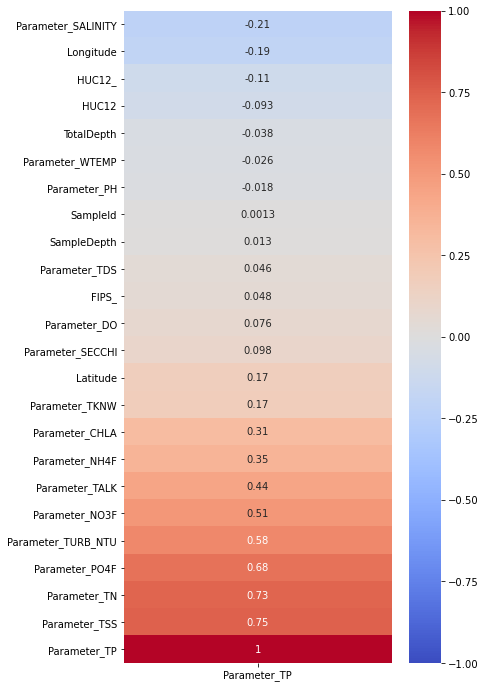

In [7]:
plt.figure(figsize=(6, 12))
sns.heatmap(water.corr()[['Parameter_TP']].sort_values('Parameter_TP'),
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            annot=True)

In [8]:
X = water._get_numeric_data().drop(columns=['Parameter_TP'])
y = water['Parameter_TP']

In [9]:
X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y,
                                                    test_size = 0.33,
                                                    random_state = 42)

In [11]:
rfr = RandomForestRegressor()

In [12]:
params = {
    'n_estimators'      : [100, 200, 300],
    'min_samples_split' : [10, 20, 30],
    'max_depth'         : [None, 5, 10]
}

In [13]:
# Set up grid search
gs = GridSearchCV(rfr, 
                  param_grid=params, 
                  return_train_score=True, 
                  n_jobs=6,
                  cv = 5)

In [14]:
# Run grid search on training data with a time check. WARNING: this search takes ~ 8 min. with n_jobs=6
import time
t0 = time.time()
gs.fit(X_train, y_train)
print(time.time() - t0)

325.6414997577667


# Evaluation

In [24]:
# Score on training set.
gs.score(X_train, y_train)

0.9725875429541367

In [25]:
# Score on testing set.
gs.score(X_test, y_test)

0.9313739562569041

In [26]:
# List best hyperparameters found in Grid Search
gs.best_params_

{'max_depth': None, 'min_samples_split': 10, 'n_estimators': 200}

In [27]:
# 5-fold cross validation score.
gs.best_score_

0.898220252645765

In [28]:
# Utilize model to get predictions on testing set.
preds = gs.predict(X_test)

In [29]:
# List scores from best features in model
gs.best_estimator_.feature_importances_

array([1.12163227e-02, 1.89119611e-03, 9.18101940e-03, 6.47957061e-03,
       3.36068777e-03, 5.03817013e-04, 2.12080980e-03, 1.22393076e-03,
       1.03039576e-02, 2.05386515e-03, 3.75940142e-03, 2.60032764e-03,
       1.95576129e-03, 5.10341495e-01, 5.37702067e-04, 7.24285813e-04,
       8.18578390e-04, 1.05126170e-03, 2.49615303e-02, 6.93855352e-02,
       3.14094230e-01, 1.64803641e-02, 4.95435023e-03])

In [30]:
# Grab feature names, their importance, and sort them into a dataframe.
features_df = pd.DataFrame(gs.best_estimator_.feature_importances_, X_train.columns, columns=['Importance'])
features_df.sort_values(by='Importance', ascending=False).head(25)

,Importance
Parameter_PO4F,0.510341
Parameter_TSS,0.314094
Parameter_TN,0.069386
Parameter_TKNW,0.024962
Parameter_TURB_NTU,0.016480
SampleId,0.011216
Parameter_CHLA,0.010304
HUC12,0.009181
Latitude,0.006480
Parameter_WTEMP,0.004954


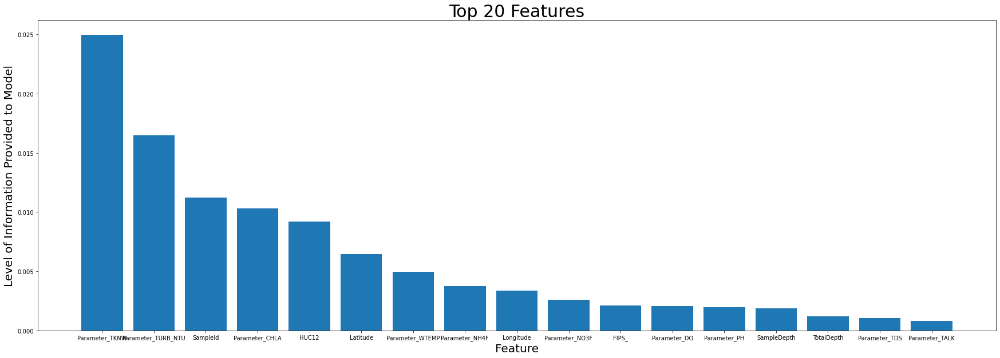

In [23]:
# plot the top features minus the top 3 ('leadership', 'leader', & 'leaders')
plt.figure(figsize=(30,10))
temp = features_df.sort_values('Importance', ascending=False).head(20)
plt.bar(temp.index[3:], temp['Importance'][3:])
plt.title('Top 20 Features', fontsize=30)
plt.xlabel('Feature', fontsize=20)
plt.ylabel('Level of Information Provided to Model', fontsize=20);

In [47]:
print(f'Training Score: {round(lm.score(Z_train, y_train),4)}')
print(f'Testing Score: {round(lm.score(Z_test, y_test),4)}')

Training Score: 0.4571
Testing Score: 0.4882
